In [11]:
import pandas as pd 
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")


In [12]:
df = pd.read_csv('credit_card_churn.csv', header=0)
#Note: Please ignore the last 2 columns (Naive Bayes Classification), we suggest better delete it before doing anything.
df = df.iloc[:,0:21]
#Drop Duplicate
df.drop_duplicates(inplace=True)

# Data Exploration


In [13]:
df.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


In [14]:
categorical_feature = list(df.select_dtypes('object').columns)
categorical_feature.remove('Attrition_Flag')
numeric_feature = list(df.select_dtypes(['int64','float64']).columns)

print("Categorical Features : " + str(len(categorical_feature)) + "\nNumerical Features   : " + str(len(numeric_feature)) + "\nOutput Feature       : Attrition_Flag" + "\n=================")
df.info()

Categorical Features : 5
Numerical Features   : 15
Output Feature       : Attrition_Flag
<class 'pandas.core.frame.DataFrame'>
Int64Index: 10127 entries, 0 to 10126
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   CLIENTNUM                 10127 non-null  int64  
 1   Attrition_Flag            10127 non-null  object 
 2   Customer_Age              10127 non-null  int64  
 3   Gender                    10127 non-null  object 
 4   Dependent_count           10127 non-null  int64  
 5   Education_Level           10127 non-null  object 
 6   Marital_Status            10127 non-null  object 
 7   Income_Category           10127 non-null  object 
 8   Card_Category             10127 non-null  object 
 9   Months_on_book            10127 non-null  int64  
 10  Total_Relationship_Count  10127 non-null  int64  
 11  Months_Inactive_12_mon    10127 non-null  int64  
 12  Contacts_Count_12_mon     1

In [15]:
#check missing values
df.isnull().sum()

CLIENTNUM                   0
Attrition_Flag              0
Customer_Age                0
Gender                      0
Dependent_count             0
Education_Level             0
Marital_Status              0
Income_Category             0
Card_Category               0
Months_on_book              0
Total_Relationship_Count    0
Months_Inactive_12_mon      0
Contacts_Count_12_mon       0
Credit_Limit                0
Total_Revolving_Bal         0
Avg_Open_To_Buy             0
Total_Amt_Chng_Q4_Q1        0
Total_Trans_Amt             0
Total_Trans_Ct              0
Total_Ct_Chng_Q4_Q1         0
Avg_Utilization_Ratio       0
dtype: int64

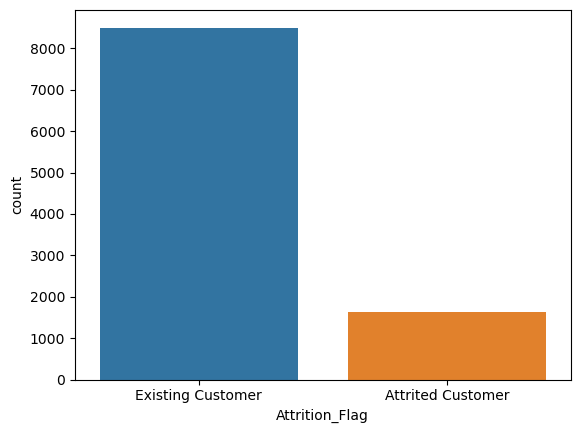

Existing Customer    8500
Attrited Customer    1627
Name: Attrition_Flag, dtype: int64
Percentage of Existing Customer :0.8393403772094401
Percentage of Attrited Customer :0.1606596227905599


In [16]:
sns.countplot(x="Attrition_Flag",data=df)
plt.show()
print(df['Attrition_Flag'].value_counts())
print("Percentage of Existing Customer :" + str(len(df[df['Attrition_Flag']=='Existing Customer'])/len(df['Attrition_Flag'])))
print("Percentage of Attrited Customer :" + str(len(df[df['Attrition_Flag']=='Attrited Customer'])/len(df['Attrition_Flag'])))

- Imbalance Class Dataset  ข้อมูลของคลาสมีจำนวนที่ห่างกันมากถึง 5 เท่า

# Numerical Data

Correlation between feature

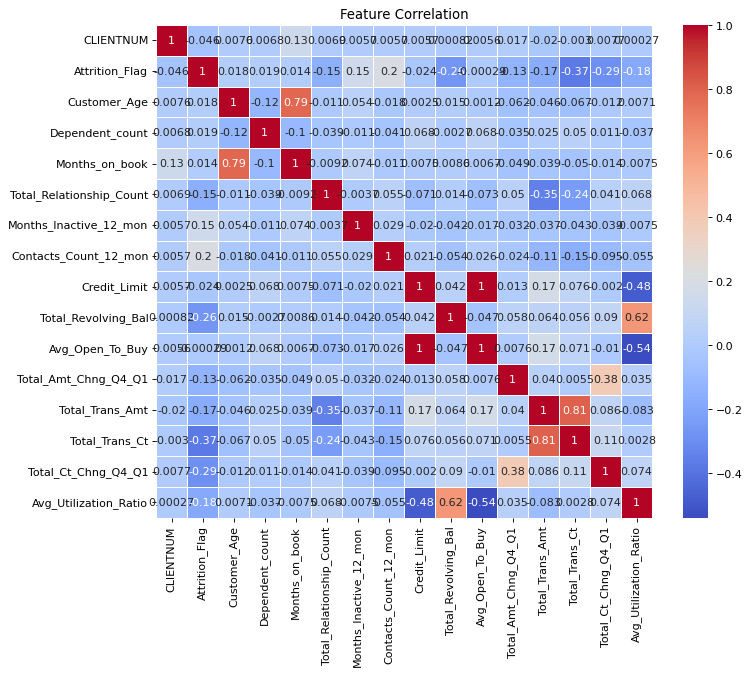

In [17]:
plt.figure(figsize=(10,8),dpi=80)
df2 = df.copy()
plt.title('Feature Correlation')
df2['Attrition_Flag'] = df2['Attrition_Flag'].replace(['Existing Customer','Attrited Customer'], [0,1])
sns.heatmap(df2.corr(),cmap="coolwarm",annot=True,linewidth=0.5)
del df2

In [18]:
df.columns

Index(['CLIENTNUM', 'Attrition_Flag', 'Customer_Age', 'Gender',
       'Dependent_count', 'Education_Level', 'Marital_Status',
       'Income_Category', 'Card_Category', 'Months_on_book',
       'Total_Relationship_Count', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Credit_Limit', 'Total_Revolving_Bal',
       'Avg_Open_To_Buy', 'Total_Amt_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct', 'Total_Ct_Chng_Q4_Q1', 'Avg_Utilization_Ratio'],
      dtype='object')

จาก Correlation ของ Heatmap ที่ได้พบว่ามี Feature ทั้งหมด 6 feature ที่มีความ correlate กับ Attrition Flag น้อยมาก ซึ่งได้แก่
* Customer_Age
* Dependent_count
* Months_on_book
* Credit_Limit
* Avg_Open_To_Buy
* ClientNum



และมี Feature ที่มี Correlation กับ Output variable  โดยที่มีค่า Correlate ดังนี้
- Total_Trans_Ct              0.37
- Total_Ct_Chng_Q4_Q1        0.29
- Total_Revolving_Bal         0.26
- Contacts_Count_12_mon      0.2
- Avg_Utilization_Ratio       0.18
- Total_Trans_Amt             0.17
- Total_Relationship_Count    0.15
- Months_Inactive_12_mon     0.15
- Total_Amt_Chng_Q4_Q1        0.13


 




และเมื่อดูจาก Correlation ของแต่ละ feature พบว่าแต่ละ feature ที่มีความสัมพันธ์ร่วมกัน หรือ Correlate ร่วมกันสูงมีดังนี้ ในขณะเดียวกันนั้น Feature ทั้งสองก็ยังมี Correlate ร่วมกับกับ Output ที่สูงด้วย
* Avg_Utilization_Ratio && Total_Revolving_Bal 0.62
* Total_Trans_Ct && Total_Trans_Amt 0.81


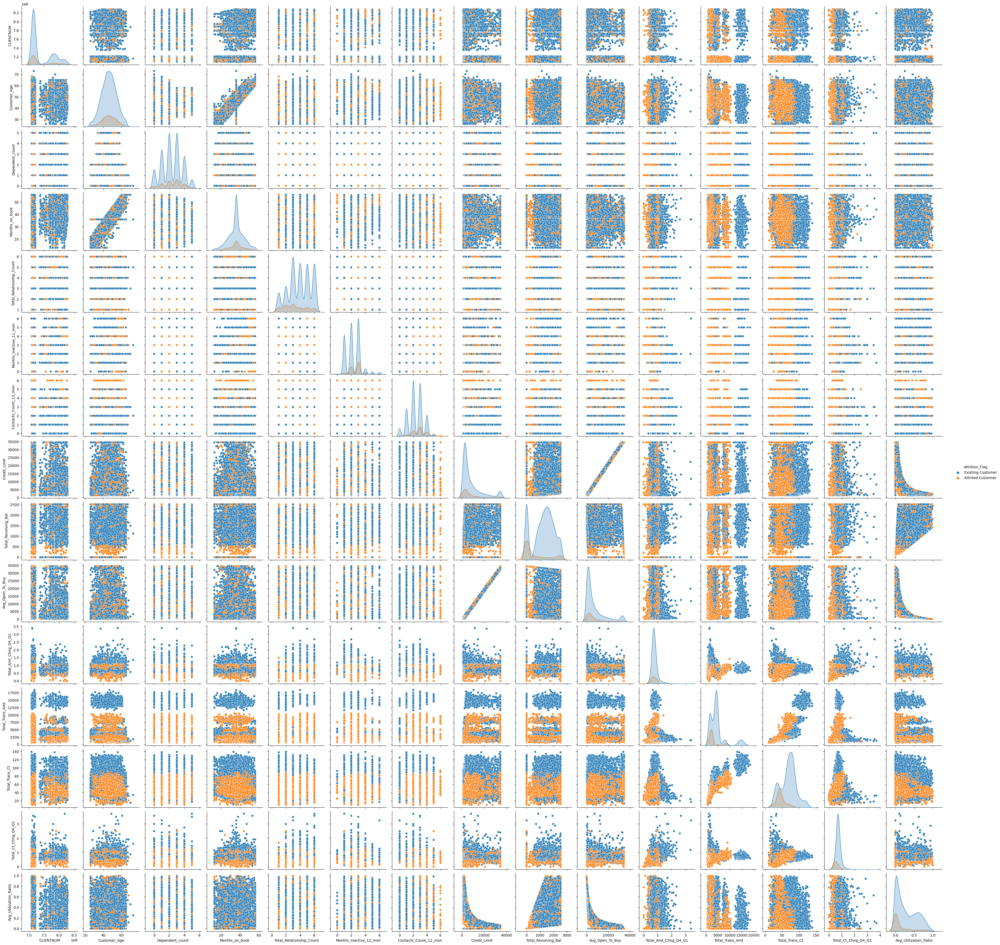

In [19]:
sns.pairplot(df,hue='Attrition_Flag')

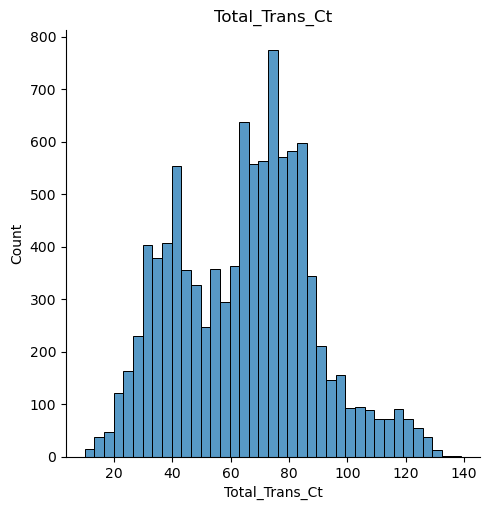

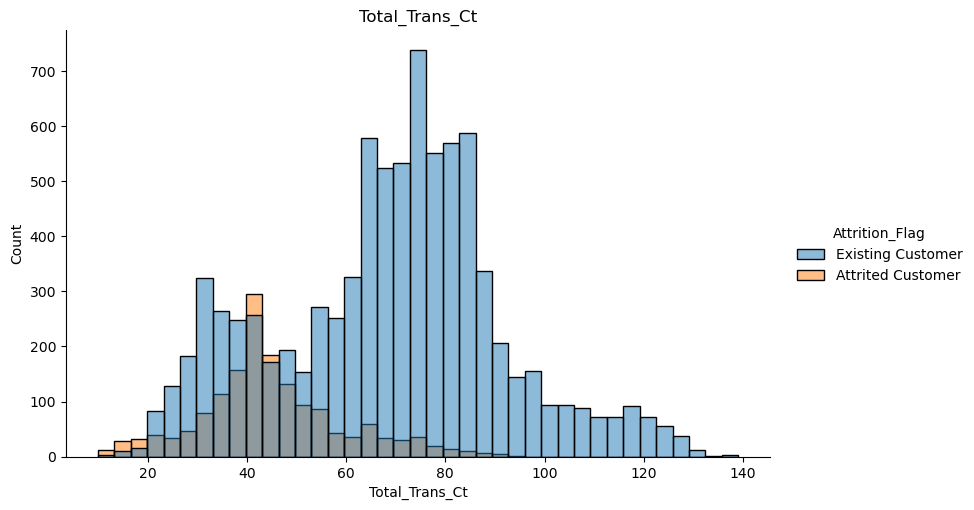

In [20]:
df_select_numeric = ['Total_Trans_Ct','Total_Amt_Chng_Q4_Q1','Total_Revolving_Bal','Contacts_Count_12_mon','Avg_Utilization_Ratio','Total_Trans_Amt','Total_Relationship_Count','Total_Ct_Chng_Q4_Q1','Months_Inactive_12_mon','Months_Inactive_12_mon']

name = df_select_numeric[0]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

จากกราฟข้อมูลจำนวน Transaction ที่ลูกค้าใช้งานทั้งหมดพบว่าลูกค้าโดยเฉลี่ยส่วนใหญ่จะมีปริมาณธุรกรรมอยู่ในช่วง 60 - 80 ในขณะที่ช่วงจำนวนในการทำธุรกรรมทั้งหมด 30 - 50 ครั้ง เป็นจำนวนที่มีลูกค้าที่เลิกใช้บริการมากที่สุด

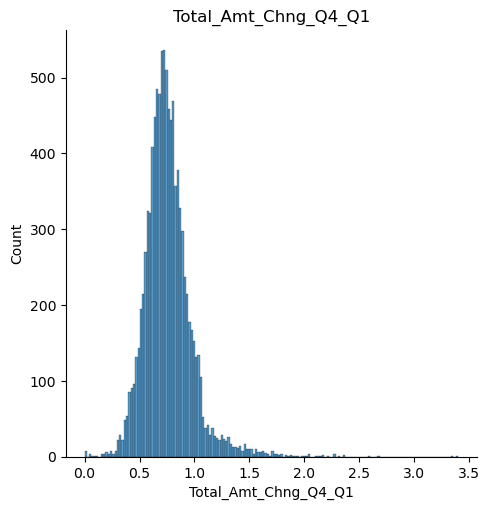

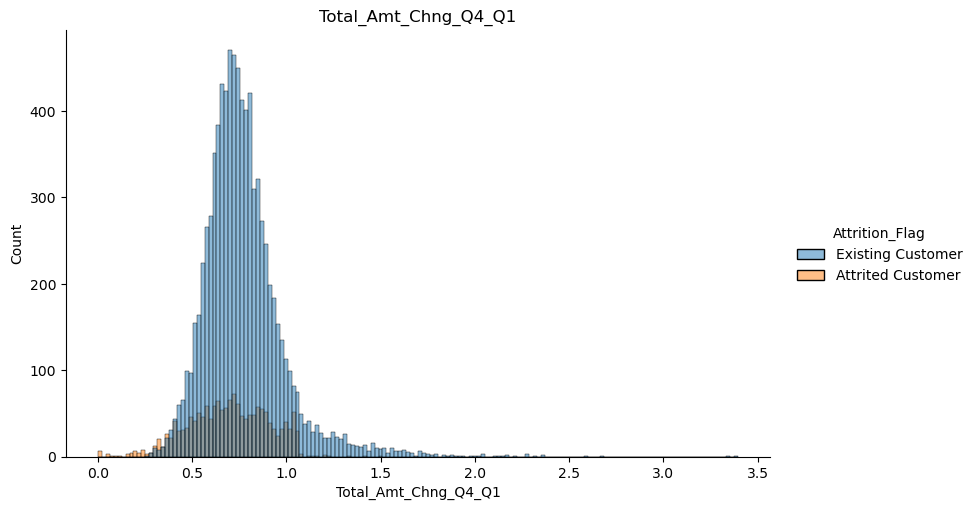

In [21]:
name = df_select_numeric[1]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

ยอดการเปลี่ยนแปลงของ Transaction จากกราฟข้อมูลจะสามารถยบอกได้ว่าหากมีการเปลี่ยนแปลง Transaction ที่มากกว่า ช่วง 1.2 ลูกค้าจะยังใช้บริการ Credit card อยู่ ในขณะที่ช่วงที่น้อยกว่า 0.5 จะมีอัตราการการเลิกใช้ของผู้ใช้งานมากกว่าปกติ

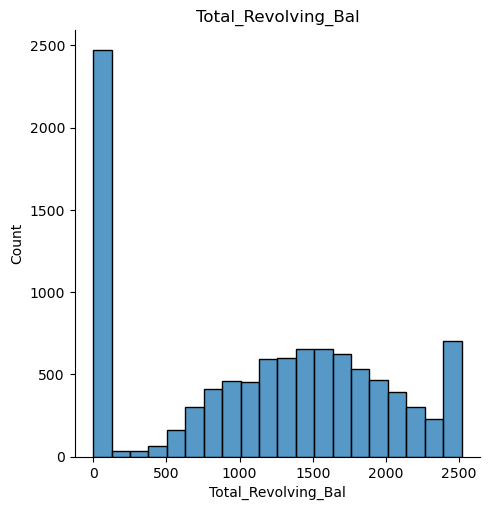

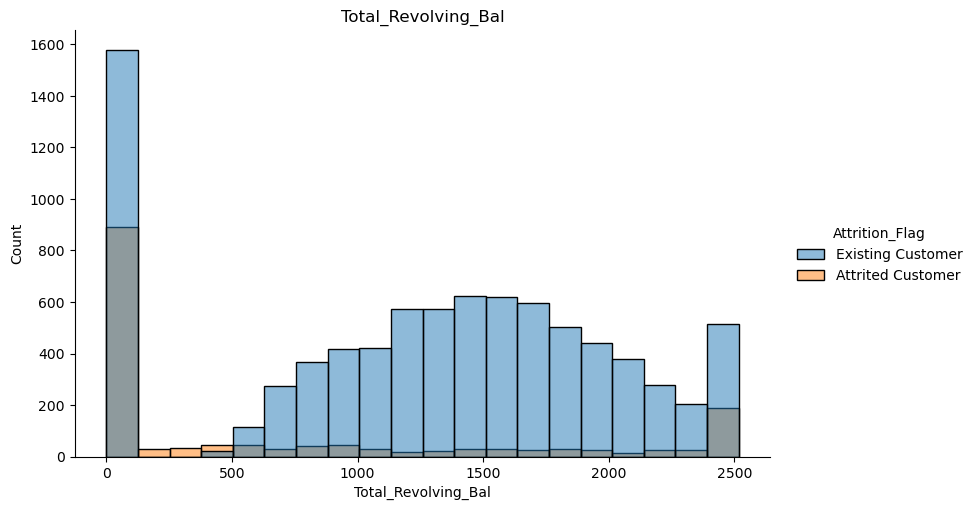

In [22]:
name = df_select_numeric[2]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

ยอดเงินหมุนเวียนพบว่าส่วนใหญ่มีเงินหมุนเวียนน้อยกว่า 500 และอัตราส่วนต้องผู้เลิกใช้งานก็มีมากกว่า 50 % ในขณะช่วงคนที่มีเงินหมุนเวียน ยังคงใช้งานบริการอยู่เป็นจำนวนมาก 

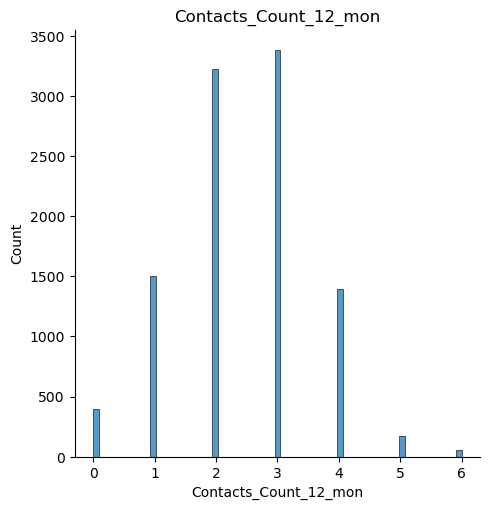

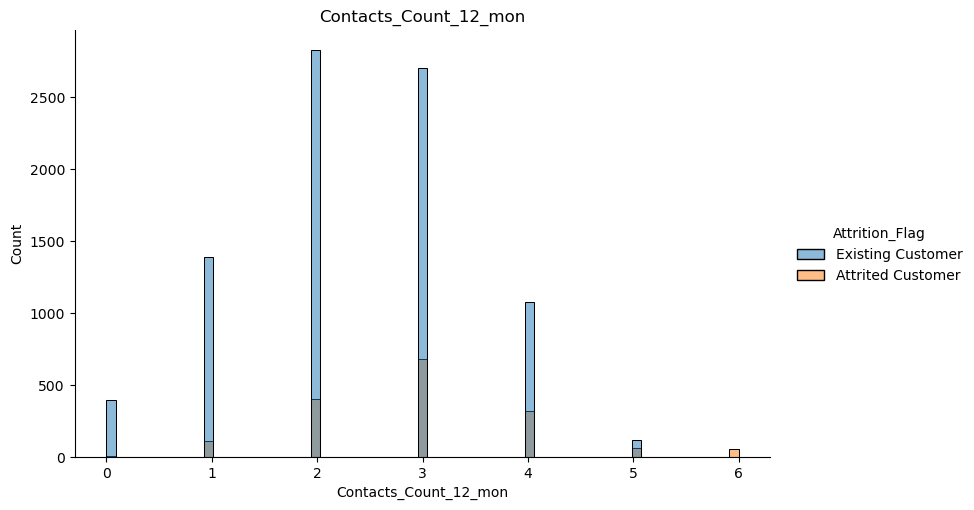

In [23]:
name = df_select_numeric[3]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

จำนวนการติดต่อในช่วง 12 เดือนที่ผ่านมา มีแนวโน้มว่าหากลูกค้ามีการติดต่อกับธนาคารที่มากขึ้น ลูกค้ามีแนวโน้มที่จะยกเลิกการใช้บริการ โดยสามารถสังเกตุได้ตั้งแต่การติดต่อครั้งที่ 3 เป็นต้นไปที่อัตราส่วนของผู้เลิกใช้บริการเริ่มมีมากขึ้นเรื่อย ๆ ในแต่ละช่วงจำนวนการติดต่อ

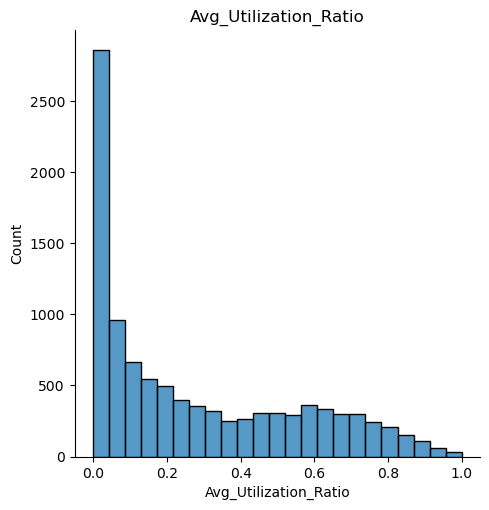

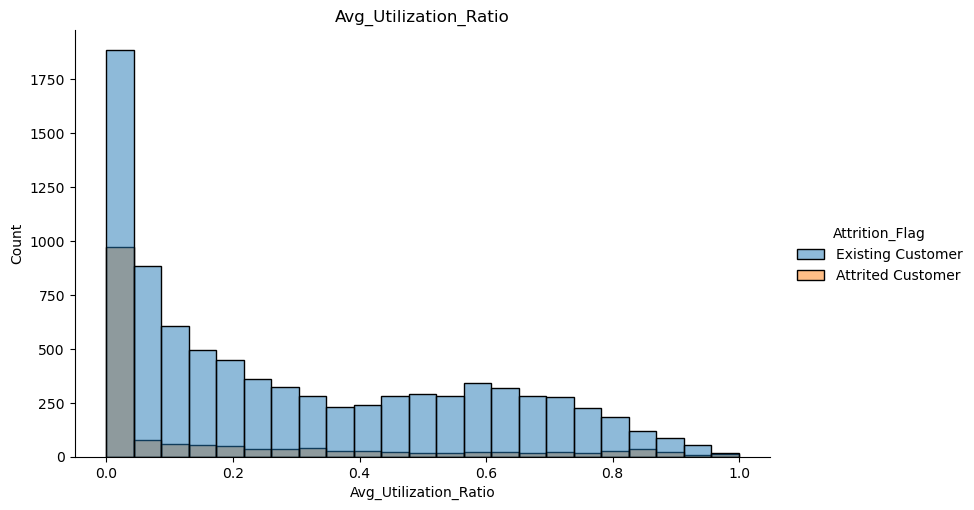

In [24]:
name = df_select_numeric[4]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

ค่าเฉลี่ยอัตราส่วนระหว่างยอดเงินในบัตรเครดิต และลิมิตของเครดิตการ์ด ซึ่งจากกราฟจะสังเกตุได้ว่าโดยเฉลี้ยนแล้วคนส่วนใหญ่ไม่มียอดคงเหลืออยู่ภายในบัตรเครดิต เมื่อนำมาเทียบกับอัตราส่วนกับลิมิตของเครดิตการ์ดจึงมีค่าเท่ากับศุนย์ ดังนั้นคนที่มีค่าเฉลี่ยอัตราส่วน = 0 ก็อาจจะมีแนวโน้มที่จะยกเลิกการใช้บริการมากกว่าคนทั่วไป

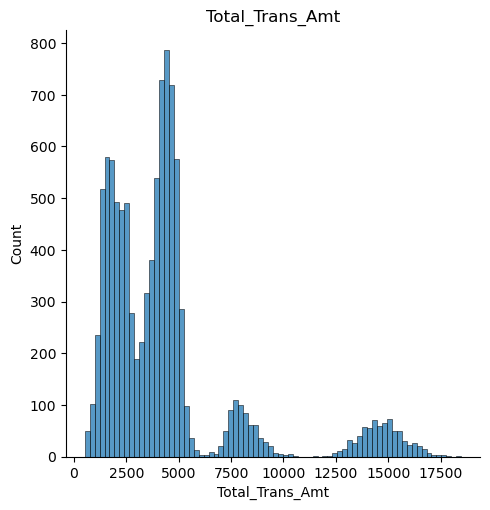

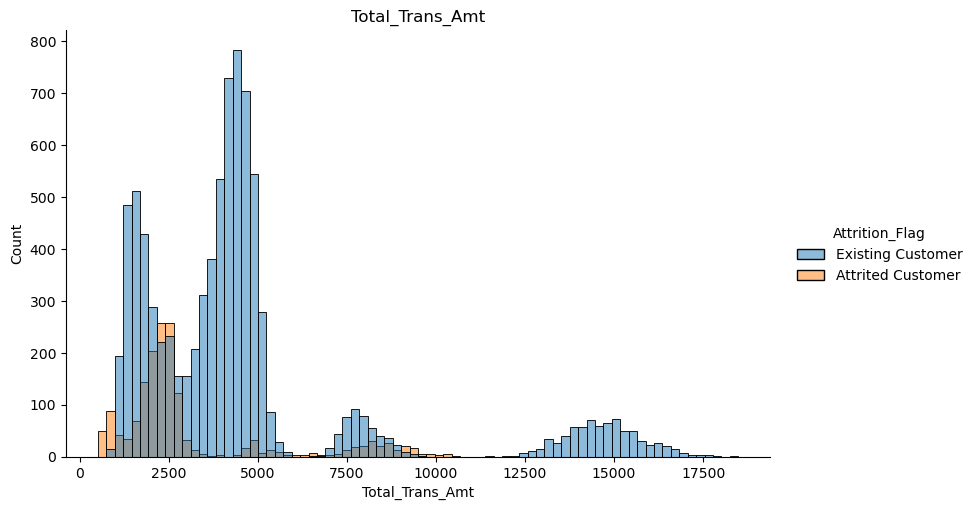

In [25]:
name = df_select_numeric[5]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

จากกราฟข้อมูลยอดการใช้เงินในช่วง 12 เดือนที่ผ่านมาพบว่า คนส่วนใหญ่จะใช้เงินอยู่ในช่วงเฉลี่ย 0 - 5000 โดยที่ส่วนใหญ่หากมีจำนวนการใช้เงินมากกว่า 12500 จะยังคงเป็นผู้ที่ใช้บริการอยู่แต่ในขณะเดียวกัน ผู้ใช้บริการที่อยู่ในช่วง < 2500 มีแนวโน้มที่จะเลิกใช้บริการมากกว่าปกติ

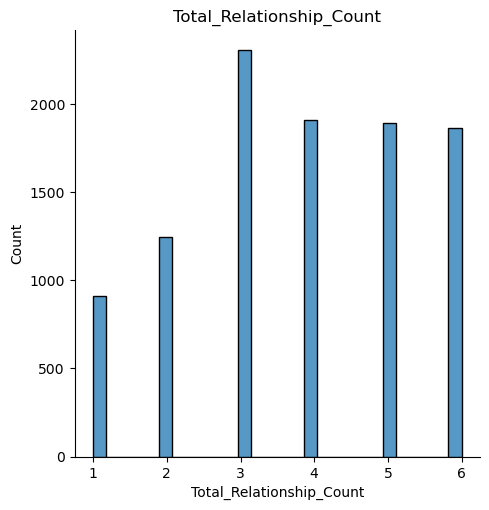

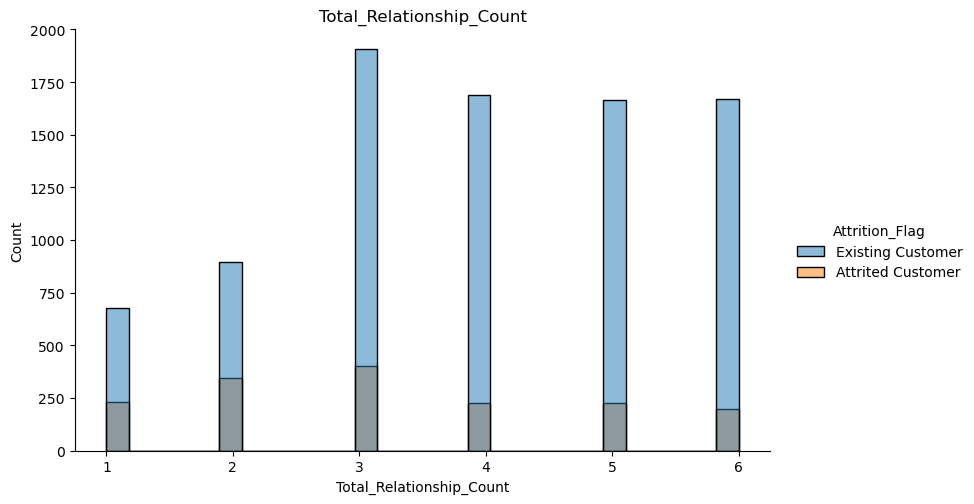

In [26]:
name = df_select_numeric[6]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

จำนวนโปรดักส์ของลูกค้า (Total number of products held by the customer) จากกราฟจะสังเกตุได้ว่าในช่วงโปรดักส์ 1 - 2 จะมีอัตตราการเลิกใช้งานบริการสูงมากกว่า จำนวน 3 - 6

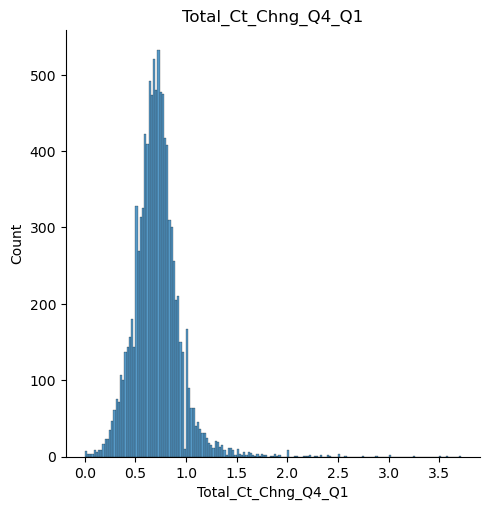

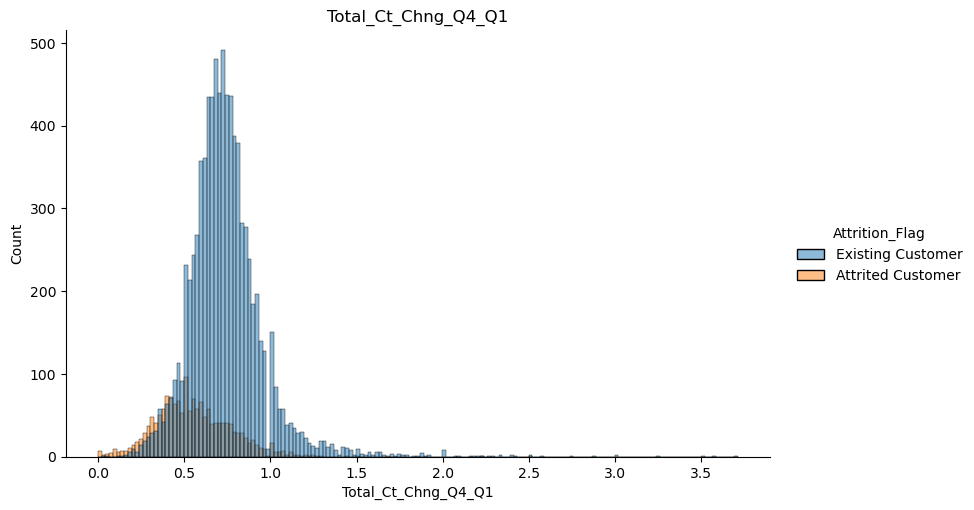

In [27]:
name = df_select_numeric[7]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

ช่วงกราฟในช่วง 0 - 0.5 ผู้ใช่งานมีแนวโน้มที่จะเลิกใช้บริการมากที่สุด

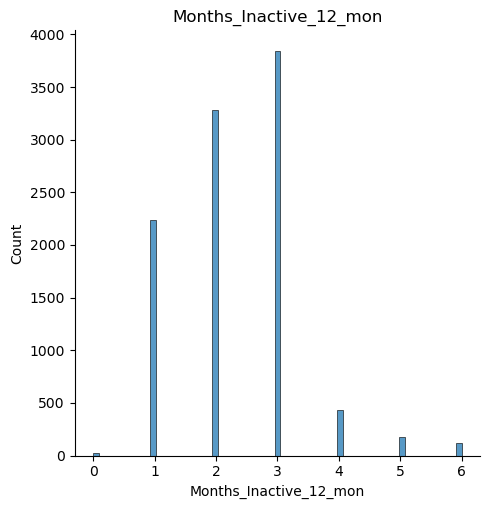

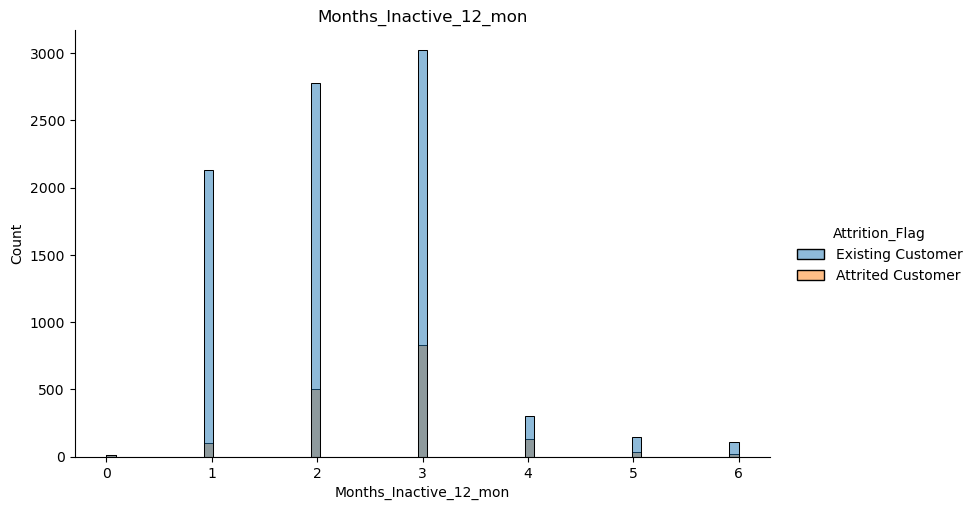

In [28]:
name = df_select_numeric[8]
sns.displot(x=df[name]).set(title=name)
sns.displot(x=df[name],hue=df['Attrition_Flag'], height=5, aspect=1.6).set(title=name)

จำนวนเดือนที่ลูกค้าไม่มีการใช้บริการมากที่สุดจะอยู่ในช่วง 2 - 3 เดือน โดยที่จะมีแนวโน้มที่จะเลิกใช้งานบริการตั้งแต่เดือนที่ 3 มากที่สุดแต่กลับพบว่า เดือนที่ 5 หรือเดือนที่ 6 ไม่ได้มีแนวโน้มของลูกค้าที่จะยกเลิกการใช้บริการที่มากขึ้น

In [29]:
df_select_numeric.remove('Months_Inactive_12_mon')

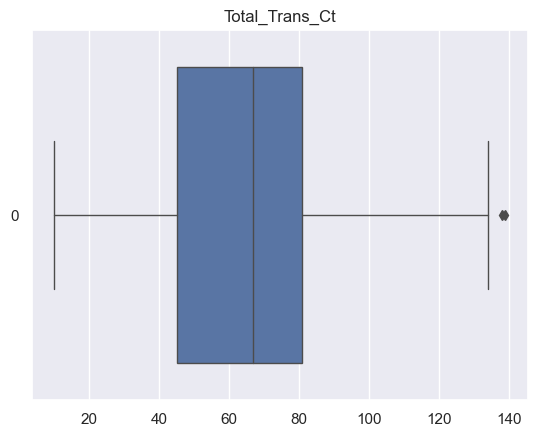

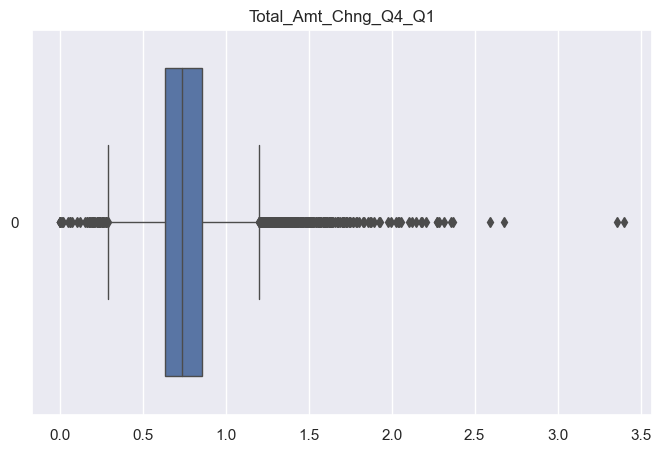

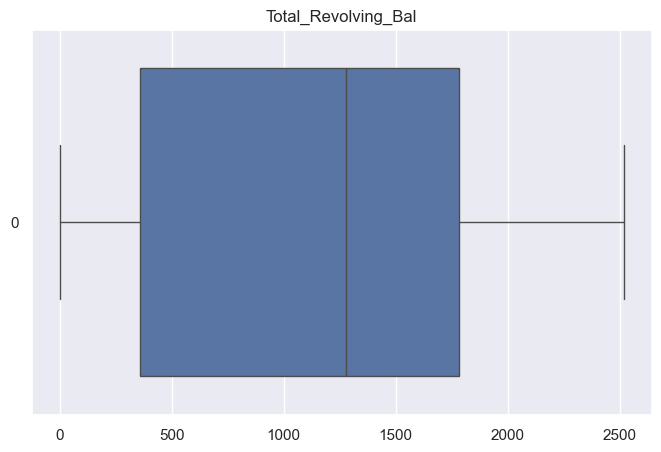

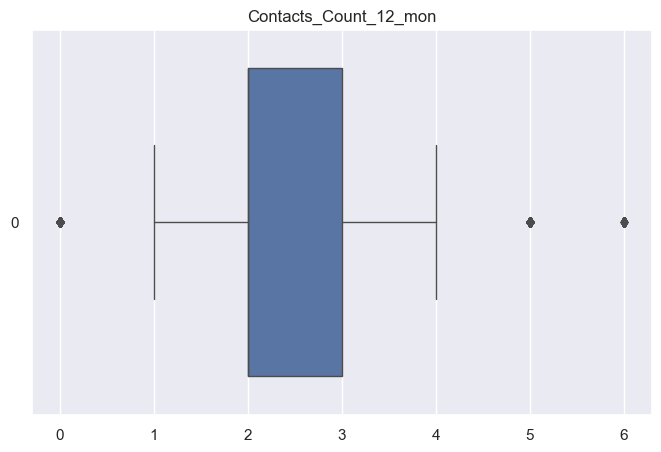

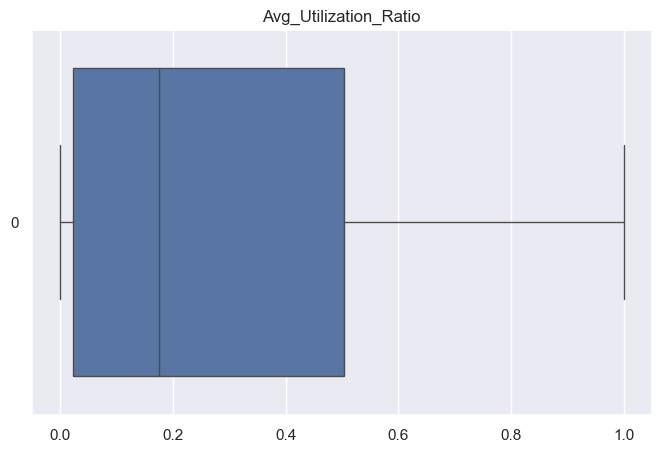

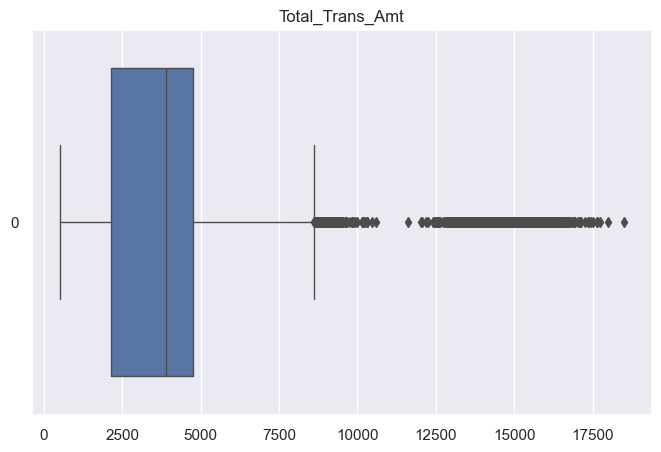

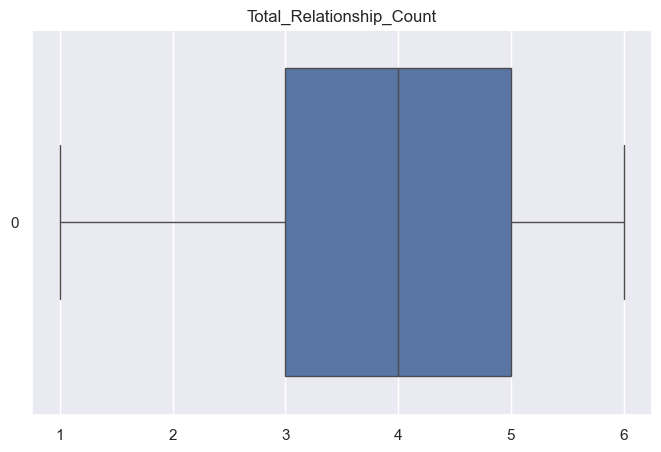

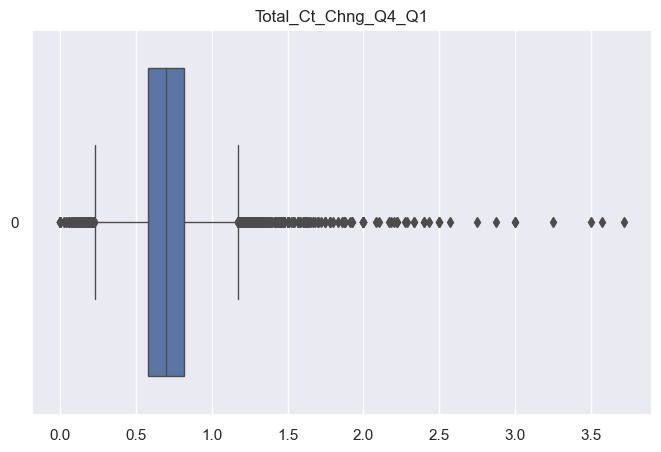

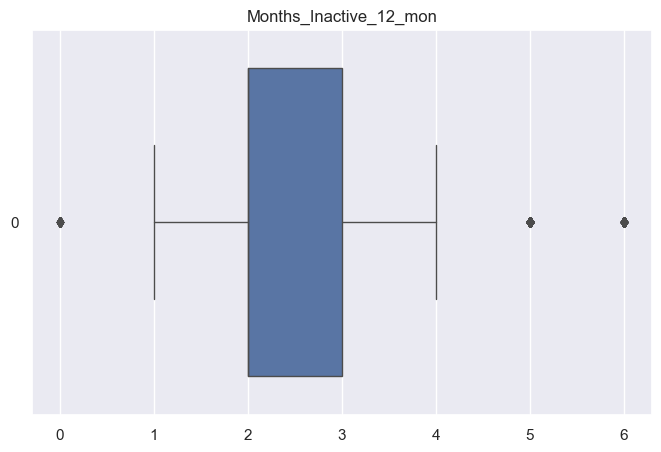

In [30]:
for col in df_select_numeric:
    plt.figure()
    plt.tight_layout()
    sns.set(rc={"figure.figsize":(8, 5)})
    sns.boxplot(data= df[col], linewidth= 1.0,orient='h').set(title=col)

In [31]:
df_outlier = df.loc[(df['Total_Trans_Ct']>130)| ((df['Total_Ct_Chng_Q4_Q1']>1.3) | (df['Total_Ct_Chng_Q4_Q1']<0.3)) | (df['Total_Amt_Chng_Q4_Q1']>1.3)]

In [32]:
len(df_outlier)

622

In [33]:
def ratio_category(class_col,col):
    for i in range(len(class_col)):
        print("Percentage of " + class_col[i]+ " to Flag = Attrited : "+str(len(df.loc[(df[col] == class_col[i]) & (df["Attrition_Flag"] == 'Attrited Customer')])/len(df.loc[(df[col] == class_col[i])])))
    return

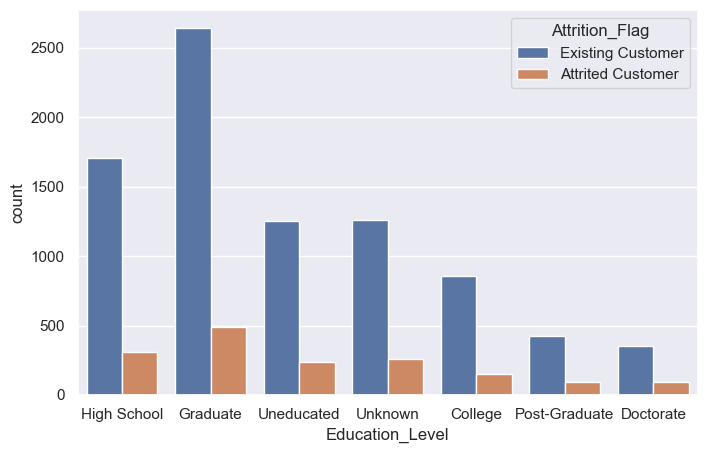

Percentage of Uneducated to Flag = Attrited : 0.1593813046402152
Percentage of High School to Flag = Attrited : 0.15201192250372578
Percentage of Post-Graduate to Flag = Attrited : 0.17829457364341086
Percentage of Graduate to Flag = Attrited : 0.15569053708439898
Percentage of College to Flag = Attrited : 0.15202369200394866
Percentage of Doctorate to Flag = Attrited : 0.2106430155210643
Percentage of Unknown to Flag = Attrited : 0.1685319289005925


In [34]:
sns.countplot(x="Education_Level",hue="Attrition_Flag",data=df)
plt.show()
ratio_category(['Uneducated','High School','Post-Graduate','Graduate','College','Doctorate','Unknown'],'Education_Level')

- จากกราฟ จะเห็นได้ว่าอัตราส่วนของ Education Level โดยเทียบกับ Attrition Flag พบว่า Doctorate มีอัตราส่วนระหว่าง Class Attrited:Existing Customer มากที่สุด
- โดยมีลูกค้าส่วนใหญ่มีการศึกษาตั้งแต่ Graduate เป็นต้นไปมากที่สุด

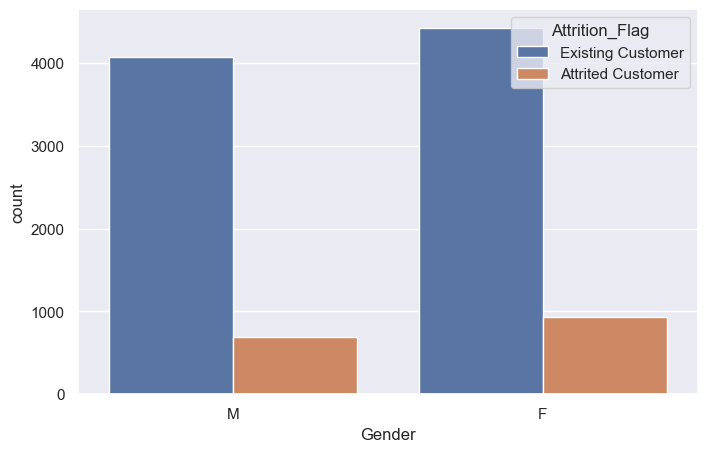

Percentage of M to Flag = Attrited : 0.14615223317257287
Percentage of F to Flag = Attrited : 0.17357222844344905


In [35]:
sns.countplot(x="Gender",hue="Attrition_Flag",data=df)
plt.show()
ratio_category(['M','F'],'Gender')

- จากกราฟอัตราส่วนของข้อมูลระหว่างผู้ชายและผู้หญิงที่ พบว่าเพศให้ผลลัพธ์หรือ Class Output มีค่าใกล้เคียงกัน แต่โดยอัตราส่วนแล้วมีโอกาสที่ผู้หญิงเลิกใช้งานมากกว่าผู้ชาย

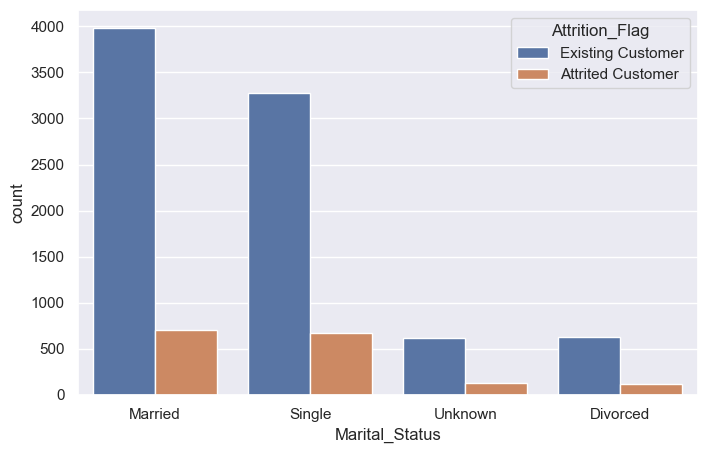

Percentage of Married to Flag = Attrited : 0.15126946874333264
Percentage of Single to Flag = Attrited : 0.16941415166117169
Percentage of Unknown to Flag = Attrited : 0.17222963951935916
Percentage of Divorced to Flag = Attrited : 0.16176470588235295


In [36]:
sns.countplot(x="Marital_Status",hue="Attrition_Flag",data=df)
plt.show()
ratio_category(["Married","Single","Unknown","Divorced"],"Marital_Status")

- จากกราฟข้อมูลลูกค้าส่วนใหญ่จะเป็นลูกค้าที่แต่งงานแล้ว และรองลงมาคือคนที่ยังโสด  โดยที่คนที่โสดจะมีอัตราส่วนที่จะถูกจัดอยู่ในประเภท Attrited Customer มากกว่า คนที่แต่งงานแล้ว แต่ค่าก็ยังไม่แตกต่างกันจนเห็นได้ชัดมากนัก

Percentage of Less than $40K to Flag = Attrited : 0.17186183656276327
Percentage of $40K - $60K to Flag = Attrited : 0.15139664804469274
Percentage of $60K - $80K to Flag = Attrited : 0.13480741797432239
Percentage of $80K - $120K to Flag = Attrited : 0.15765472312703582
Percentage of $120K + to Flag = Attrited : 0.1733149931224209
Percentage of Unknown to Flag = Attrited : 0.1681654676258993


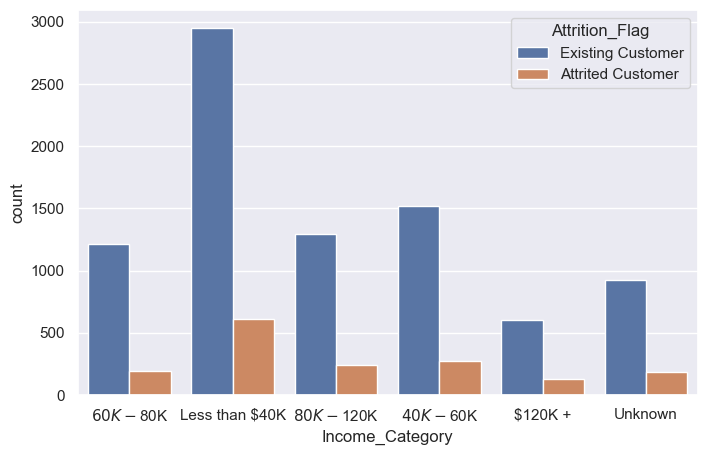

In [37]:
sns.countplot(x="Income_Category",hue="Attrition_Flag",data=df)
ratio_category(['Less than $40K',"$40K - $60K",'$60K - $80K','$80K - $120K','$120K +',"Unknown"],"Income_Category")

- จากข้อมูลพบว่าผู้ที่ยังใช้งานส่วนใหญ่มีรายได้เฉลี่ยอยู่ที่น้อยกว่า 40K และรองลงมาคือ 40K-60K และช่วงรายได้ที่ยังเป็นลูกค้าที่ใช้งานอยู่ปัจจุบันมากที่สุดคือในช่วง 60K-80K

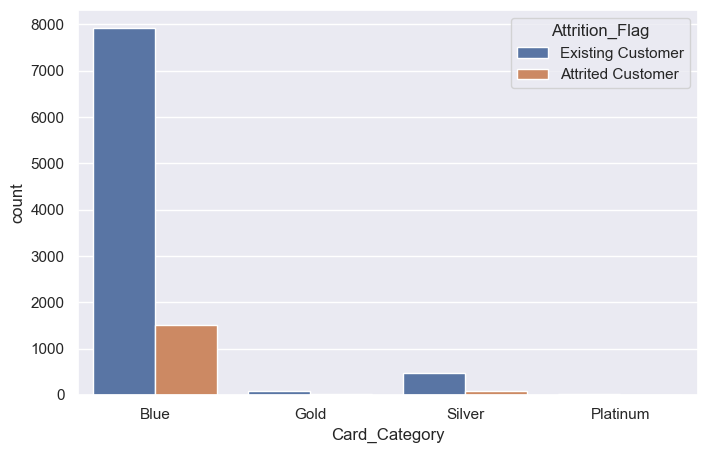

Percentage of Blue to Flag = Attrited : 0.1609792284866469
Percentage of Gold to Flag = Attrited : 0.1810344827586207
Percentage of Silver to Flag = Attrited : 0.14774774774774774
Percentage of Platinum to Flag = Attrited : 0.25


In [38]:
sns.countplot(x="Card_Category",hue="Attrition_Flag",data=df)
plt.show()
ratio_category(["Blue","Gold","Silver","Platinum"],"Card_Category")

# Feature Selection

Numeical data
-
Feature ที่เลือก โดยที่เลือก Base on จาก Correlation ระหว่าง Feature และ Output
- 'Total_Trans_Ct'   - จำนวน Transaction ทั้งหมด
- 'Total_Amt_Chng_Q4_Q1' - การเปลี่ยนแปลงยอดของ Transaction ตั้งแต่ Q4-Q1
- 'Total_Revolving_Bal' - ยอดหมุนเวียนในบัญชีหรือ Credit card
- 'Contacts_Count_12_mon' - จำนวนครั้งในการติดต่อตั้งแต่ 12 เดือนที่ผ่านมา
- Months_Inactive_12_mon - จำนวนเดือนที่ไม่มีการใช้งานในช่วง 12 เดือนที่ผ่านมา
- 'Avg_Utilization_Ratio' - ค่าเฉลี่ยอัตราส่วนระหว่าง ยอดคงเหลือของเครดิตการ์ด และยอดลิมิตของเครดิตการ์ด
- 'Total_Trans_Amt'     -   จำนวน Transaction ในช่วง 12 เดือนที่ผ่านมา
- 'Total_Relationship_Count' - จำนวนโปรดักส์ที่ลูกค้ามี
- 'Total_Ct_Chng_Q4_Q1' - ยอดการเปลี่ยนแปลงรายการทั้งหมด

Categorical Data
- Education Level
- Gender
- Income_Category


# Preprocessing

In [39]:
from sklearn import preprocessing

le = preprocessing.LabelEncoder()
scaler = preprocessing.MinMaxScaler()


Cut Outlier and Features

In [40]:
df_clean = df.copy()
#Cut Outlier
df_clean = pd.concat([df_clean, df_outlier, df_outlier]).drop_duplicates(keep=False)
#Feature Selection
df_select = df_select_numeric[::]
select_cat = ['Education_Level','Gender','Income_Category']
for i in select_cat:
    df_select.append(i)


In [41]:
X = df_clean.loc[:,df_select]
Y = df_clean['Attrition_Flag']


In [42]:
print(df.shape)
print(df_clean.shape)
print(X.shape)

(10127, 21)
(9505, 21)
(9505, 12)


Scale data With MinMaxScaler

Scale Data เพื่อให้การคำนวณ Distance ของการทำ Clustering อยู่ในช่วงเสกลที่ไม่ห่างกันมากจนเกินไปจนทำให้การทำ Clustering ผิดพลาด

In [43]:
for feature in df_select_numeric:
    X[[feature]] = scaler.fit_transform(X[[feature]])

In [44]:
for i in select_cat:
    X[i] = le.fit_transform(X[i])

# Clustering  Scaling and Outlier

In [45]:
from sklearn.metrics import silhouette_score
def result(df1,df2,model_label,class_num):
    df1['Clusters'] = model_label
    fig, axes = plt.subplots(1, 2, figsize=(15, 5), sharey=True)
    c1 = sns.scatterplot(df1['Total_Trans_Amt'], df1['Avg_Utilization_Ratio'], hue=df1['Clusters'], 
        palette=sns.color_palette('hls', class_num),alpha=1,ax=axes[0])
    c2 = sns.scatterplot(df2['Total_Trans_Amt'], df2['Avg_Utilization_Ratio'], hue=df2['Attrition_Flag'],ax=axes[1])   
    print('Silhoutte score of this model is ' + str(silhouette_score(df1, model_label)))
    return

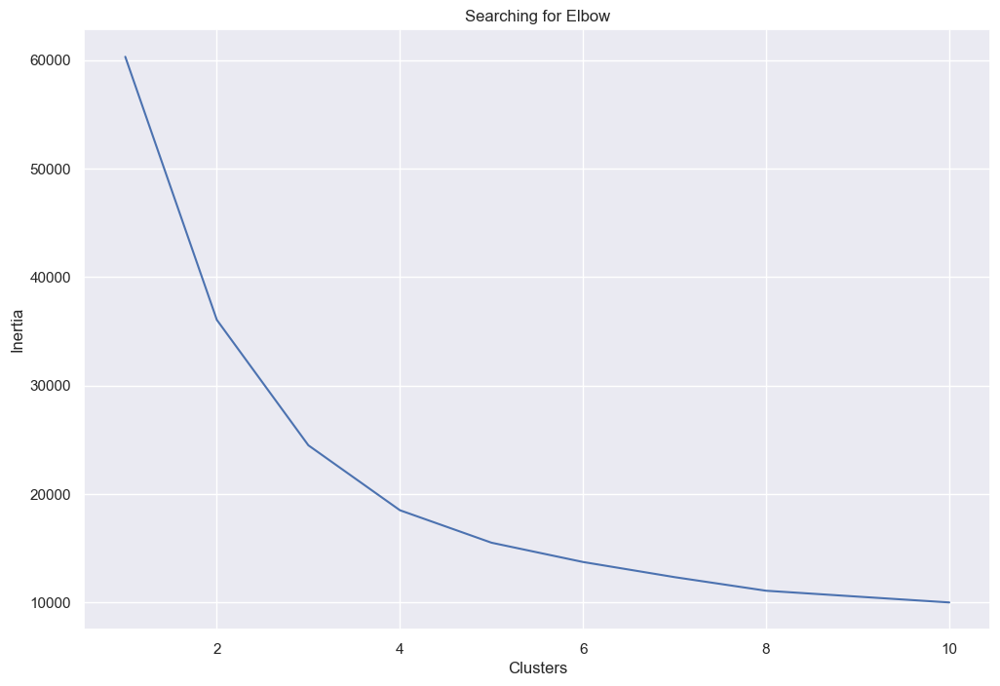

In [46]:
from sklearn.cluster import KMeans

clusters = []
for i in range(1, 11):
    km = KMeans(n_clusters=i).fit(X)
    X['Labels'] = km.labels_
    clusters.append(km.inertia_)
X.drop(axis=1,inplace=True,columns="Labels")    
fig, ax = plt.subplots(figsize=(12, 8))
sns.lineplot(x=list(range(1, 11)), y=clusters, ax=ax)
ax.set_title('Searching for Elbow')
ax.set_xlabel('Clusters')
ax.set_ylabel('Inertia')
plt.show()

Silhoutte score of this model is 0.4231287324676835


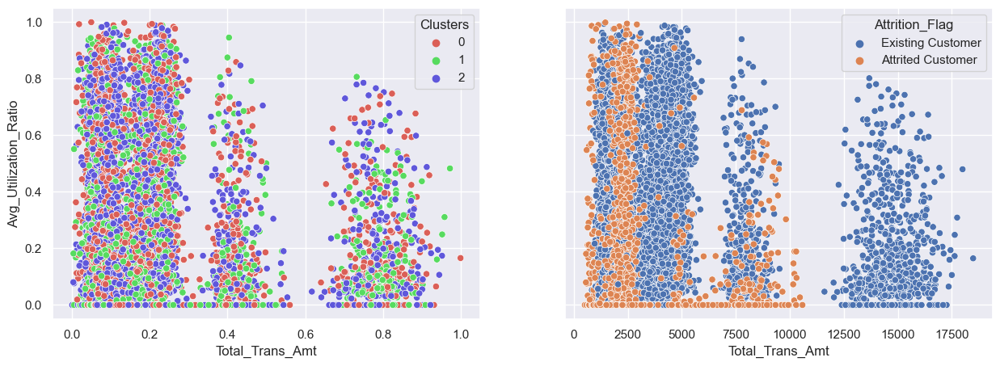

In [47]:
class_n = 3
km3 = KMeans(n_clusters=class_n).fit(X)
result(X,df,km3.labels_,class_n)   

Silhoutte score of this model is 0.45593885781621113


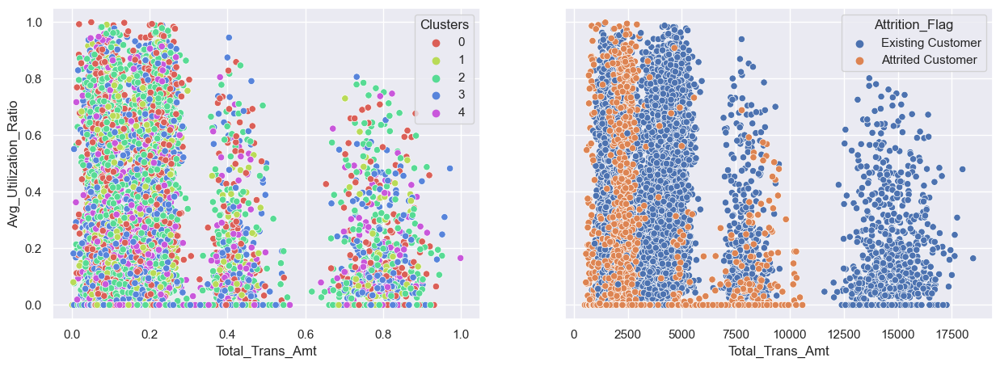

In [48]:
class_n = 5
km5 = KMeans(n_clusters=class_n).fit(X)
result(X,df,km5.labels_,class_n)   

Silhoutte score of this model is 0.3787763651523645


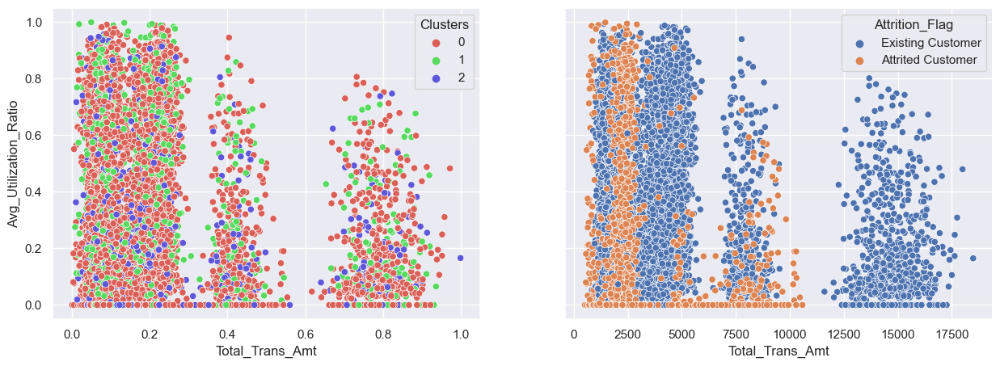

In [49]:
from sklearn.cluster import AgglomerativeClustering 
class_n = 3
agglom = AgglomerativeClustering(n_clusters=class_n, linkage='average').fit(X)
result(X,df,agglom.labels_,class_n)   

Silhoutte score of this model is 0.4515252355891446


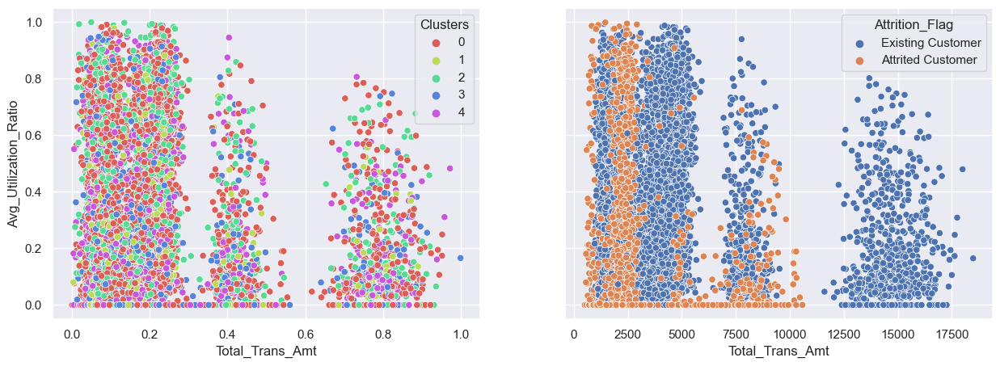

In [50]:
class_n = 5
agglom = AgglomerativeClustering(n_clusters=class_n, linkage='average').fit(X)
result(X,df,agglom.labels_,class_n)   

Drop Unnecessary Features


In [51]:
X = df_clean.loc[:,df_select]
for feature in df_select_numeric:
    X[[feature]] = scaler.fit_transform(X[[feature]])
for i in select_cat:
    X[i] = le.fit_transform(X[i])

<Figure size 800x640 with 0 Axes>

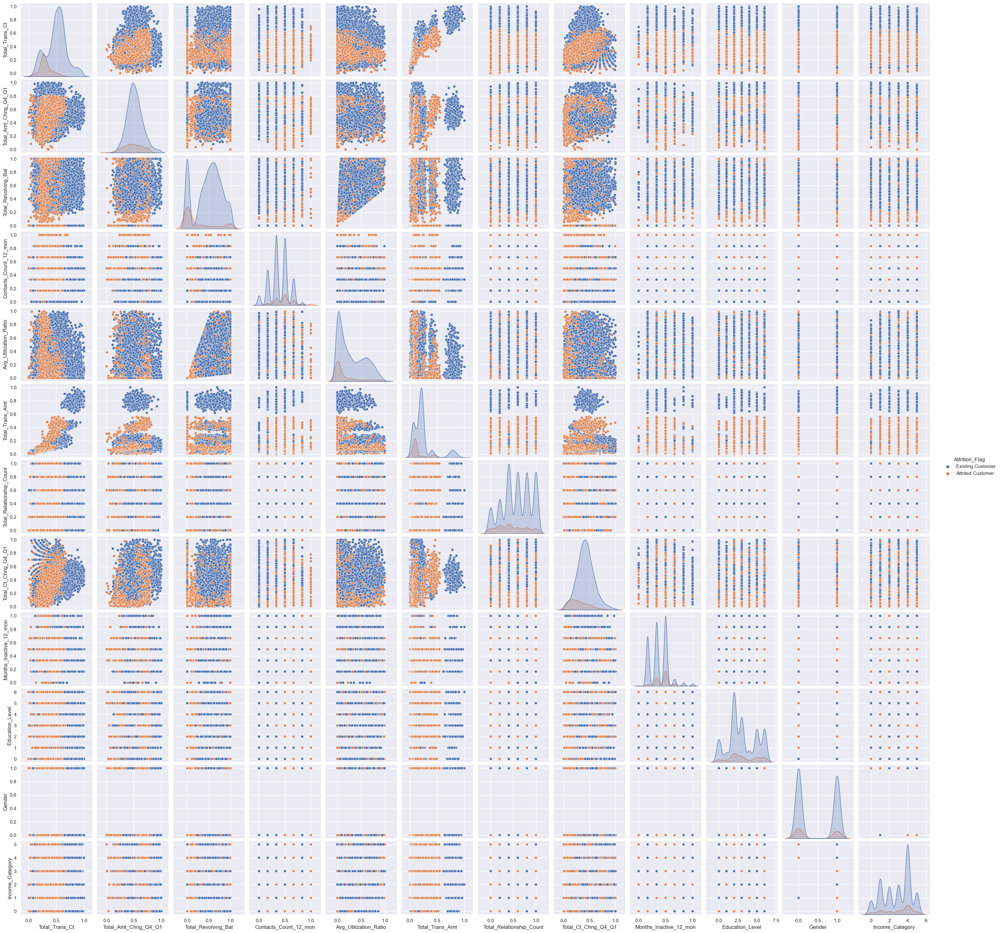

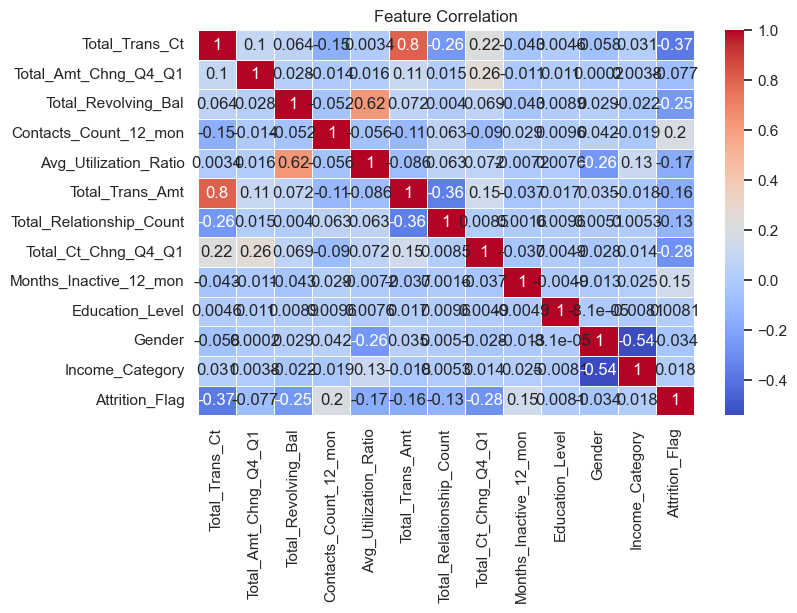

In [52]:
plt.figure(figsize=(10,8),dpi=80)
df2 = X.copy()
df2['Attrition_Flag'] = Y

sns.pairplot(df2,hue='Attrition_Flag')
plt.show( )
df2['Attrition_Flag'] = df2['Attrition_Flag'].replace(['Existing Customer','Attrited Customer'], [0,1])
plt.title('Feature Correlation')
sns.heatmap(df2.corr(),cmap="coolwarm",annot=True,linewidth=0.5)
plt.show()
del df2

จาก Heatmap จะสังเกตุได้ว่าค่า Correlate ระหว่าง Categortical Feature เทียบกับ Output ที่เราต้องการแล้วค่าที่ได้มีความสัมพันธ์ร่วมกันน้อยมาก จึงเลือก Drop Categorical Feature ทิ้ง และ Total_Trans_Ct กับ Totlal_Trans_Amt ที่มีค่า Correlate ที่สูงมาก แต่ว่าเนื่องจากการ Pairplot ก่อนหน้าพบว่า Total_Trans_Amt สามารถใช้ในการแยกกลุ่ม Cluster มีการแยกออกจากกันค่อนข้างชัดเจนมากกว่า Total_Trans_Ct จึงเลือกดรอป feature Total_Trans_Ct

In [53]:
def ScaleandSelectFeatureX():
    X = df_clean.loc[:,df_select]
    for feature in df_select_numeric:
        X[[feature]] = scaler.fit_transform(X[[feature]])
    X.drop(columns=select_cat,axis=1,inplace=True)
    X.drop(columns="Total_Trans_Ct",axis=1,inplace=True)
    return X

In [54]:
X = ScaleandSelectFeatureX()

Silhoutte score of this model is 0.5301758793337261


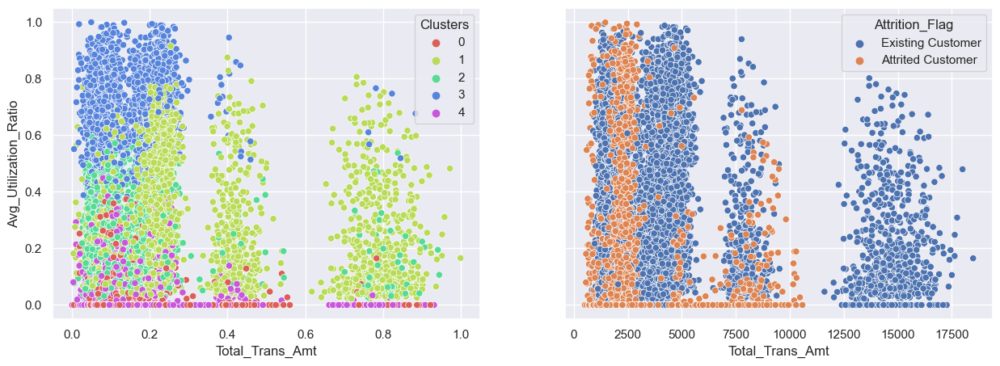

In [55]:
class_n = 5
km5 = KMeans(n_clusters=class_n).fit(X)
result(X,df,km5.labels_,class_n)   

Silhoutte score of this model is 0.541428037542967


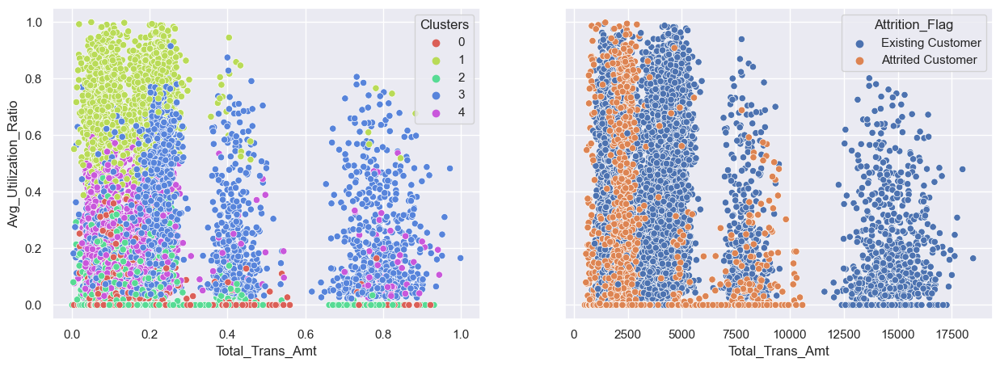

In [56]:
class_n = 5
agglom = AgglomerativeClustering(n_clusters=class_n, linkage='average').fit(X)
result(X,df,agglom.labels_,class_n)   

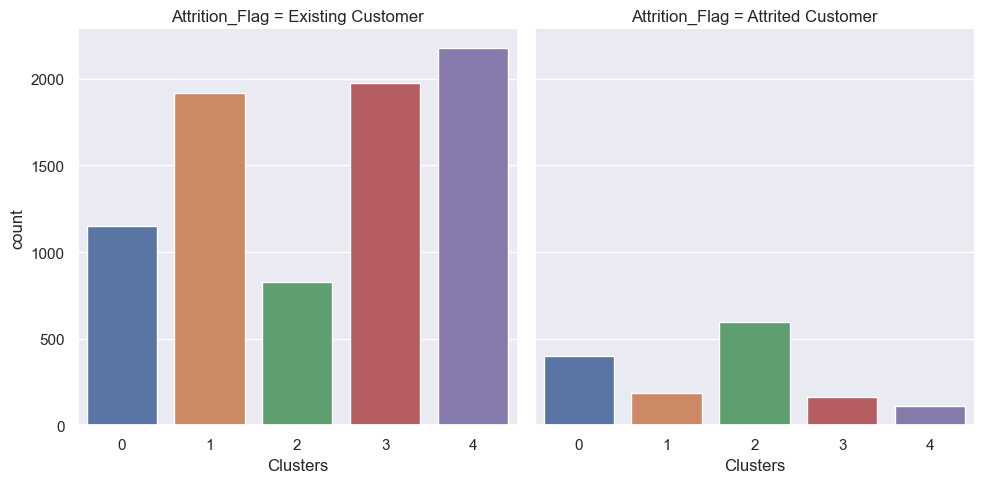

In [57]:
X = X.set_index(Y.index)
X["Attrition_Flag"] = Y
sns.catplot(x='Clusters', col='Attrition_Flag', kind='count', data= X)

PCA Feature Extraction Dimension Reduction

การใช้ PCA ในการลดมิติ Feature ของข้อมูลเพื่อตรวจสอบความแตกต่างระหว่างผลลัพธ์ที่เกิดขึ้น โดยเลือกให้ข้อมูลยังสามารถเก็บข้อมูลที่อยู่คงเดิมหลังจากการลดมิติของ ขอ้มูลลงให้อยู่ในค่าอย่างน้อย 0.95

In [58]:
from sklearn.decomposition import PCA

X = ScaleandSelectFeatureX()
print(X.shape)
pca = PCA(.9)
X = pca.fit_transform(X)
print(X.shape)
X = pd.DataFrame(X)


(9505, 8)
(9505, 6)


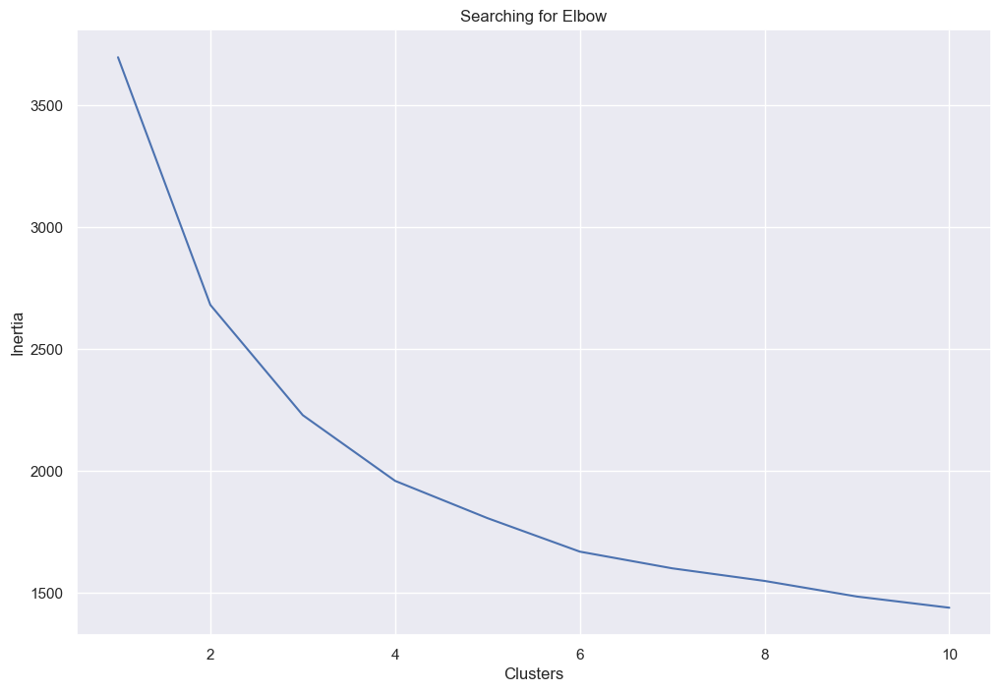

In [59]:
clusters = []
for i in range(1, 11):
    km = KMeans(n_clusters=i).fit(X)
    X['Labels'] = km.labels_
    clusters.append(km.inertia_)
X.drop(axis=1,inplace=True,columns="Labels")
fig, ax = plt.subplots(figsize=(12, 8))
sns.lineplot(x=list(range(1, 11)), y=clusters, ax=ax)
ax.set_title('Searching for Elbow')
ax.set_xlabel('Clusters')
ax.set_ylabel('Inertia')
plt.show()

Silhoutte score of this model is 0.5434855721521957


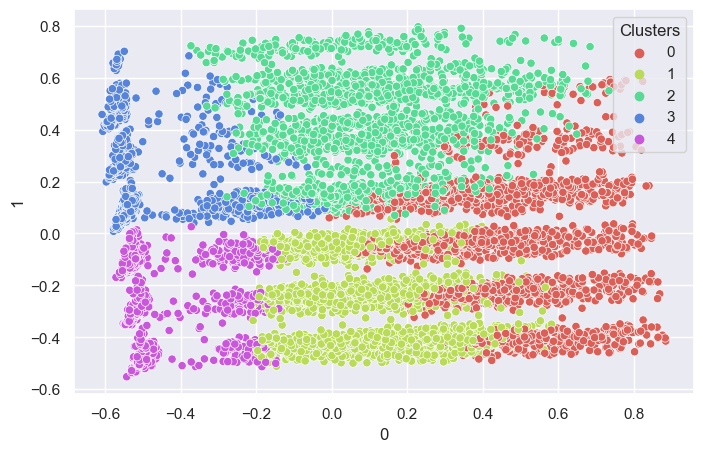

In [60]:
class_n = 5
km5 = KMeans(n_clusters=class_n).fit(X)
X['Clusters'] = km5.labels_
c1 = sns.scatterplot(X[0], X[1], hue=X['Clusters'], 
    palette=sns.color_palette('hls', 5),alpha=1)
print('Silhoutte score of this model is ' + str(silhouette_score(X, km5.labels_)))

Silhoutte score of this model is 0.5457894570767903


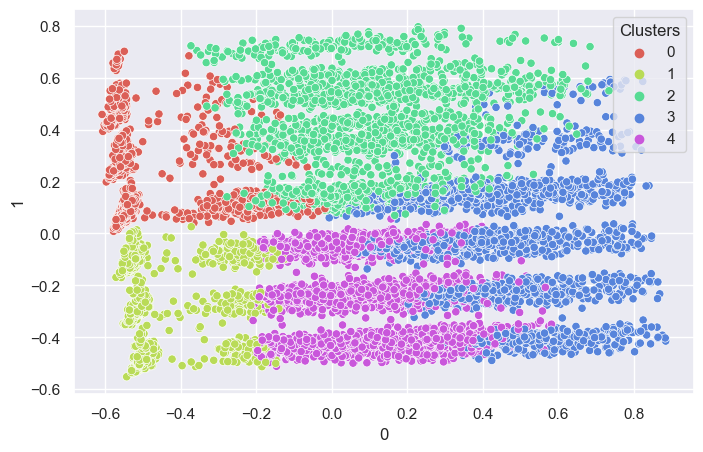

In [61]:
agglom = AgglomerativeClustering(n_clusters=class_n, linkage='average').fit(X)
X['Clusters'] = agglom.labels_
print('Silhoutte score of this model is ' + str(silhouette_score(X, agglom.labels_)))
c1 = sns.scatterplot(X[0], X[1], hue=X['Clusters'], 
    palette=sns.color_palette('hls', 5),alpha=1)
plt.show()


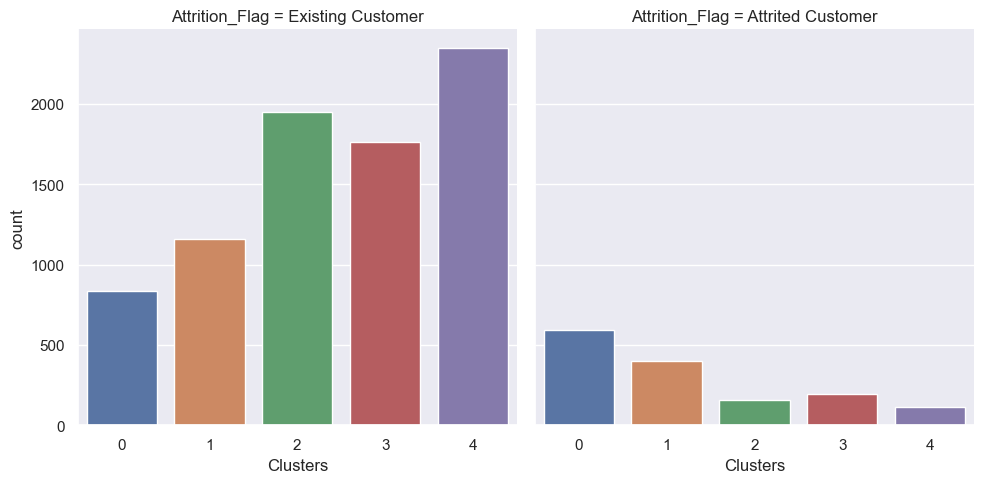

In [62]:
X = X.set_index(Y.index)
X["Attrition_Flag"] = Y
sns.catplot(x='Clusters', col='Attrition_Flag', kind='count', data= X)

Result Analysis

- การทำ PCA สามารถช่วยลด Dimension ของ Feature ที่เกิดขึ้นได้รวมทั้งยั่งส่งผลต่อ Distribution ของข้อมูลในการเลือกกลุ่ม Cluster ได้ดีขึ้นกว่าเดิม
- หารกเราสามารถมีข้อมูลแนวทางในการ หรือมีข้อมูลของกลุ่มเป้าหมายที่เราต้องการที่จะจัดกลุ่มเบื้องต้นจะสามารถช่วยให้เราเลือก Feature สำหรับการทำ Clustering ได้ดีมากยิ่งขึ้น
- การเลือกใช้ Elbow Method ในการเลือกกลุ่ม Cluster จากการทดลองจะสังเกตุได้ว่าจุดที่สามารถเป็น Optimal N number จากกราฟค่อนข้างสังเกตุได้ยากดังนี้นการนำค่า N ที่ได้มาเปรียบเทียบกับ Silhouette Score พร้อมกันก็จะช่วยทำให้สามารถเลือกค่า K ที่ดีที่สุดได้
- จากการจัดกลุ่ม 5 Cluster พบว่าโมเดลสามารถจัดกลุ่ม Cluster ที่ค่อนข้างสามารถแยกข้อมูลของ Attired Customer กับ Existed Customer ได้ดีเมื่อเทียบกับจำนวนของข้อมูลในแต่ละ Clusters